# Jazz Style Transfer

Inspired by the awe strucking results in the paper [A Neural Algorithm of Artistic Style](https://arxiv.org/abs/1508.06576) that demonstrated the transferring of artistic style from one image to another, as shown below.

![](figures/style_transfer_eg.png)

I wanted to see if the same idea can be applied to music. Is there a way to change the style of the music while preserving its 'identity'? To simplify the problem I decided to see if there is a way to transfer the style of jazz to music of other genre.

Motivated by the success of the [seq2seq network](https://github.com/google/seq2seq) in translation, which can be also be viewed as a 'style transfer' task, where the language (style) of the sentence is changed but the meaning persists. However, the lacked of parallel dataset or 'rosetta stone' in music means that different ways of training is needed.

The seq2seq network can be understood as an encoder decoder network. The encoder encodes the input into a latent representation and the decoder decodes the representation into the an output of another style. Since I don't have a parallel dataset of musics with their jazz version counter parts, I decided to train the seq2seq network as an autoencoder. This will train the decoder to decode latent representations into jazz like music and also train the encoder to encode music into latent representation.

Below is a peek into the result of the trained network:

In [9]:
import IPython

print("The Original Furelis")
display(IPython.display.Audio("songs/furelis_og.wav"))
print("The Jazzified Furelis")
display(IPython.display.Audio("songs/furelis_jazzy.wav"))

The Original Furelis


The Jazzified Furelis


## Dataset

The jazz melody dataset I used was the [Weimar Jazz Database (WJazzD)](http://jazzomat.hfm-weimar.de/dbformat/dboverview.html). The dataset provides ~500 MIDI files of different jazz melody. The MIDI files were preprocessed into frames of one-hot vector of size 129. The first 128 parts of the vector represent the pitch of the frame while the last part of the vector represents if the frame is silence. Each frame represents 1/20 second of the song.

As mentioned in the seq2seq paper, the encoder input is reversed to reduce the distance between the input and target. Furthermore, the model uses the teacher forcing technique where the label of prior timestep is feed in as input in the decoder. In our dataset, the input to the encoder is termed as **flipped**, the teacher forcing sequence is termed as **decoder_input_data** and the label of the network is termed as **encoder_input_data**.

In [3]:
import numpy as np
import os

def add_silence(total_songs):
    on_off = np.logical_not(np.any(total_songs, 0)).astype(np.float32)
    total_songs = np.vstack((total_songs, on_off))
    return total_songs

def load_dataset():
    try:
        decoder_input_data = np.load('dataset/decoder_input_data_30.npy')
        encoder_input_data = np.load('dataset/encoder_input_data_30.npy')

    except:
        total_songs = None
        for root, dirs, files in os.walk('dataset/'):
            for file in files:
                if file[-3:] == "npy":
                    x = np.clip(np.load(os.path.join(root, file)), 0, 1)
                    if total_songs is None:
                        total_songs = x
                    else:
                        total_songs = np.hstack((total_songs, x))
        
        total_songs = add_silence(total_songs)
        total_songs = total_songs.T
        size = total_songs.shape[0]
        print size
        frame_ps = 20
        second_per_set = 30
        encoder_input_data = np.array(np.split(total_songs[1:size/frame_ps/second_per_set*frame_ps*second_per_set+1, :], size/frame_ps/second_per_set, axis = 0))
        decoder_input_data = np.array(np.split(total_songs[:size/frame_ps/second_per_set*frame_ps*second_per_set, :], size/frame_ps/second_per_set, axis = 0))
        np.save('dataset/encoder_input_data_30.npy', encoder_input_data)
        np.save('dataset/decoder_input_data_30.npy', decoder_input_data)
    
    flipped = np.flip(encoder_input_data, 1)
    return flipped, encoder_input_data, decoder_input_data

## Model

In our encoder decoder model, the learned latent representation is the output of each layer of the encoder. The output is feed into decoder as its initial state. This can be seen in the model built below.

In [4]:
import keras
from keras import Sequential
from keras.models import Model
from keras.layers import CuDNNLSTM, LSTM, RepeatVector, StackedRNNCells, Input, Dense, TimeDistributed, Dropout
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
import keras.backend as K
from keras.utils.vis_utils import plot_model
from IPython.display import Image, display

Using TensorFlow backend.


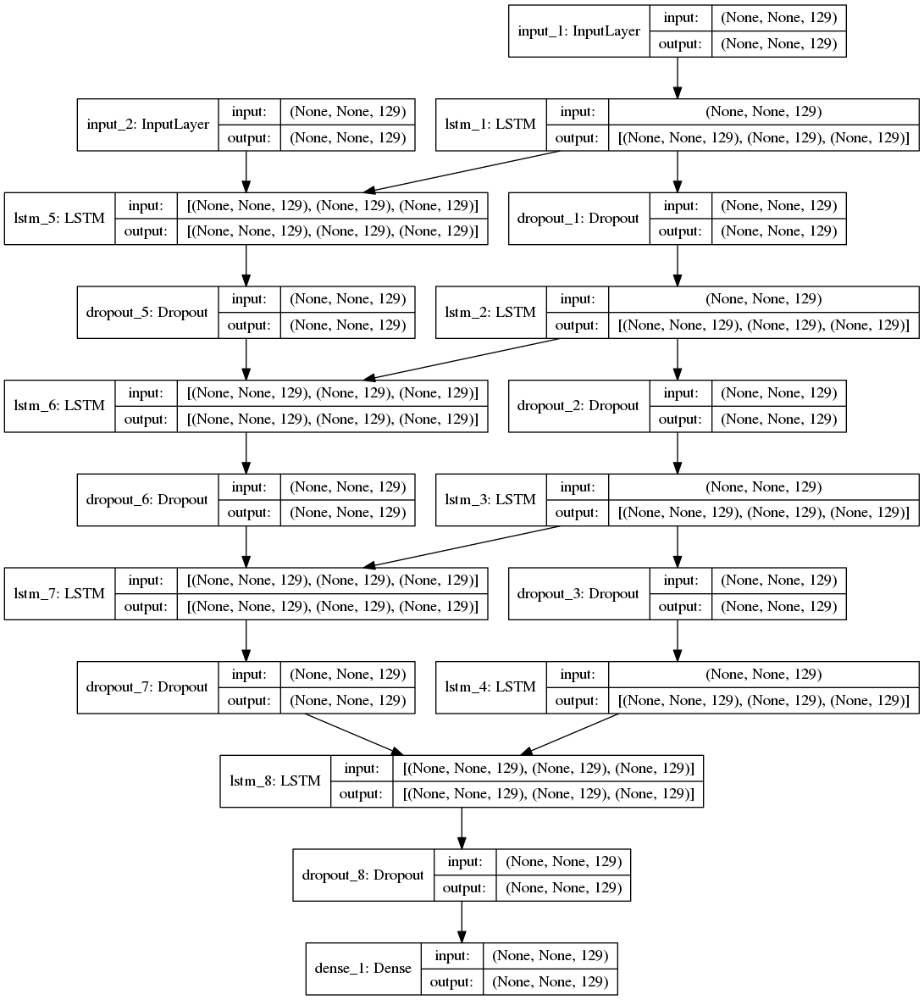

In [5]:
# configure
num_encoder_tokens = 129
num_decoder_tokens = 129
latent_dim = 129
num_layers = 4
dropout = 0.3
GPU = False

encoder_list = []
encoder_outputs_list = []
decoder_list = []
decoder_outputs_list = []
state_h_list = []
state_c_list = []
states_list = []

def lstm(latent_dim, return_state, return_sequences):
    if GPU:
        return CuDNNLTM(latent_dim, return_state=return_state, return_sequences=return_sequences)
    else:
        return LSTM(latent_dim, return_state=return_state, return_sequences=return_sequences)

encoder_inputs = Input(shape=(None, num_encoder_tokens))

encoder = lstm(latent_dim, return_state=True, return_sequences=True)
encoder_list.append(encoder)
encoder_outputs, state_h, state_c = encoder(encoder_inputs)
encoder_outputs_list.append(encoder_outputs)
state_h_list.append(state_h)
state_c_list.append(state_c)
states_list.append([state_h, state_c])
encoder_outputs = Dropout(dropout)(encoder_outputs)

for n in range(num_layers-1):
    encoder = lstm(latent_dim, return_state=True, return_sequences=True)
    encoder_list.append(encoder)
    encoder_outputs, state_h, state_c = encoder(encoder_outputs)
    encoder_outputs_list.append(encoder_outputs)
    state_h_list.append(state_h)
    state_c_list.append(state_c)
    states_list.append([state_h, state_c])
    encoder_outputs = Dropout(dropout)(encoder_outputs)

encoder_states = [state_h_list[0], state_c_list[0]]
decoder_inputs = Input(shape=(None, num_decoder_tokens))
decoder_lstm = lstm(latent_dim, return_sequences=True, return_state=True)
decoder_outputs, _, _ = decoder_lstm(decoder_inputs, initial_state=encoder_states)
decoder_list.append(decoder_lstm)
decoder_outputs = Dropout(dropout)(decoder_outputs)
for n in range(1, num_layers):
    encoder_states = [state_h_list[n], state_c_list[n]]
    decoder_lstm = lstm(latent_dim, return_sequences=True, return_state=True)
    decoder_outputs, _, _ = decoder_lstm(decoder_outputs, initial_state=encoder_states)
    decoder_list.append(decoder_lstm)
    decoder_outputs = Dropout(dropout)(decoder_outputs)

# decoder_dense = TimeDistributed(Dense(num_decoder_tokens, activation='sigmoid'))
decoder_dense = Dense(num_decoder_tokens, activation='softmax')
decoder_outputs = decoder_dense(decoder_outputs)

    
model = Model([encoder_inputs, decoder_inputs], decoder_outputs)
# plot the model
plot_model(model, to_file='figures/model.png', show_shapes=True)
display(Image(filename='figures/model.png'))

In [6]:
flipped, encoder_input_data, decoder_input_data = load_dataset()

In [7]:
print encoder_input_data.shape

(1549, 600, 129)


In [ ]:
# Run training
from keras import optimizers
batch_size = 32
epochs = 200

rmsprop = optimizers.RMSprop(lr=0.01, rho=0.9, epsilon=1e-08, decay=0.0)
adam = optimizers.Adam(lr=0.01, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10, verbose=1, mode='auto', epsilon=0.0001, cooldown=0, min_lr=0)
checkpoint = ModelCheckpoint('AutoEncoderLstm.{epoch:02d}-{val_loss:.2f}.hdf5', monitor='val_loss', verbose=1, save_best_only=True, save_weights_only=False, mode='auto', period=1)
model.compile(optimizer=rmsprop, loss='categorical_crossentropy')
model.fit([flipped, decoder_input_data], encoder_input_data,
          batch_size=batch_size,
          epochs=epochs,
          validation_split=0.2,
          callbacks=[reduce_lr, checkpoint])
model.save('LSTMAutoencoderFourLayers30Dropout.h5')

In [8]:
model = keras.models.load_model('LSTMAutoencoderFourLayers30Dropout.h5')